In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
import plotly.express as px

In [2]:
df_ori = pd.read_csv('./Results_21Mar2022.csv')
df_mean = df_ori.filter(like='mean_', axis=1)
means_new_order = ['mean_ghgs_ch4','mean_ghgs_n2o','mean_ghgs','mean_acid','mean_land','mean_bio','mean_watuse','mean_watscar','mean_eut']
df_mean = df_mean[means_new_order]
mean_cols = df_mean.columns
# print(df_mean)
select_columns = ['sex', 'age_group', 'diet_group'] + mean_cols.to_list()
df_selected = df_ori[select_columns]
print(df_selected)

          sex age_group diet_group  mean_ghgs_ch4  mean_ghgs_n2o  mean_ghgs  \
0      female     20-29       fish       1.164643       0.343663   5.421821   
1      female     30-39       fish       1.154118       0.326868   5.436673   
2      female     40-49       fish       1.108404       0.310324   5.289333   
3      female     50-59       fish       1.032501       0.298130   5.169020   
4      female     60-69       fish       1.098828       0.310735   5.380268   
...       ...       ...        ...            ...            ...        ...   
71995    male     30-39     veggie       1.769398       0.482313   6.615301   
71996    male     40-49     veggie       1.605406       0.446074   6.185949   
71997    male     50-59     veggie       1.468003       0.431966   5.871454   
71998    male     60-69     veggie       1.492114       0.437879   5.922496   
71999    male     70-79     veggie       1.644123       0.488487   6.339353   

       mean_acid  mean_land    mean_bio  mean_watus

In [3]:
# correlation between mean_columns
mean_corr = df_mean.corr()
mask = np.array(mean_corr)
mask[np.tril_indices_from(mask)] = False
mean_corr = mean_corr.round(2)
print(mean_corr)

               mean_ghgs_ch4  mean_ghgs_n2o  mean_ghgs  mean_acid  mean_land  \
mean_ghgs_ch4           1.00           0.85       0.93       0.85       0.82   
mean_ghgs_n2o           0.85           1.00       0.91       0.91       0.76   
mean_ghgs               0.93           0.91       1.00       0.92       0.92   
mean_acid               0.85           0.91       0.92       1.00       0.74   
mean_land               0.82           0.76       0.92       0.74       1.00   
mean_bio                0.76           0.62       0.73       0.56       0.69   
mean_watuse             0.50           0.47       0.47       0.48       0.33   
mean_watscar            0.33           0.35       0.30       0.33       0.23   
mean_eut                0.87           0.85       0.88       0.92       0.72   

               mean_bio  mean_watuse  mean_watscar  mean_eut  
mean_ghgs_ch4      0.76         0.50          0.33      0.87  
mean_ghgs_n2o      0.62         0.47          0.35      0.85  
mean_ghgs 

In [4]:
# Min-Max Normalization
scaler = MinMaxScaler()
df_normalized = df_selected.copy()
df_normalized[mean_cols] = scaler.fit_transform(df_selected[mean_cols])
df_normalized

,sex,age_group,diet_group,mean_ghgs_ch4,mean_ghgs_n2o,mean_ghgs,mean_acid,mean_land,mean_bio,mean_watuse,mean_watscar,mean_eut
0,female,20-29,fish,0.206959,0.159248,0.189852,0.232166,0.077412,0.307195,0.155132,0.164895,0.213057
1,female,30-39,fish,0.204977,0.147124,0.190648,0.242734,0.078357,0.301112,0.164500,0.185196,0.217693
2,female,40-49,fish,0.196371,0.135182,0.182755,0.249005,0.075381,0.279785,0.164049,0.196644,0.216222
3,female,50-59,fish,0.182081,0.126380,0.176309,0.254920,0.071900,0.248541,0.168156,0.218604,0.223397
4,female,60-69,fish,0.194568,0.135479,0.187626,0.270095,0.076823,0.267044,0.177253,0.242626,0.233846
...,...,...,...,...,...,...,...,...,...,...,...,...
71995,male,30-39,veggie,0.320815,0.259329,0.253791,0.197817,0.116250,0.427915,0.117241,0.149692,0.140136
71996,male,40-49,veggie,0.289941,0.233170,0.230790,0.185459,0.104771,0.383456,0.106712,0.141726,0.128007
71997,male,50-59,veggie,0.264072,0.222987,0.213941,0.176732,0.094130,0.349110,0.093758,0.121836,0.118778
71998,male,60-69,veggie,0.268612,0.227255,0.216675,0.181255,0.095062,0.357614,0.093711,0.110056,0.117561


            mean_ghgs_ch4  mean_ghgs_n2o  mean_ghgs  mean_acid  mean_land  \
diet_group                                                                  
meat100          0.446980       0.513496   0.511511   0.571418   0.293046   
meat50-100       0.271272       0.297457   0.304080   0.385655   0.140067   
meat50           0.193241       0.196690   0.209964   0.286435   0.078110   
fish             0.149573       0.154194   0.174399   0.241797   0.052769   
veggie           0.134315       0.130338   0.141454   0.206366   0.048412   
vegan            0.016182       0.068774   0.039350   0.060064   0.019964   

            mean_bio  mean_watuse  mean_watscar  mean_eut  
diet_group                                                 
meat100     0.267644     0.248843      0.324924  0.448933  
meat50-100  0.192539     0.213705      0.263210  0.295133  
meat50      0.158790     0.187731      0.235028  0.214814  
fish        0.147654     0.192907      0.249405  0.184531  
veggie      0.144380   

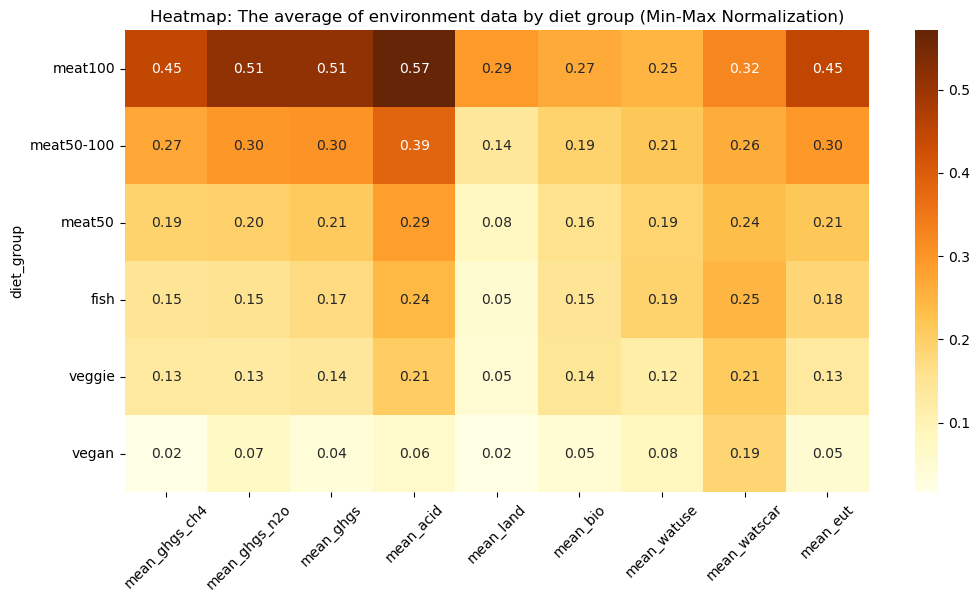

In [5]:
diet_means = df_normalized.groupby('diet_group')[mean_cols].mean()
# diet_means_sorted = diet_means.sort_values(by='mean_ghgs', ascending=False)
custom_diet_order = ['meat100','meat','meat50','fish','veggie','vegan']
diet_group_map = {
  'meat': 'meat50-100',
}
diet_means_sorted = diet_means.reindex(custom_diet_order)
# print(diet_means_sorted)
diet_means_sorted_rename = diet_means_sorted.rename(index=diet_group_map)
print(diet_means_sorted_rename)

age_means = df_normalized.groupby('age_group')[mean_cols].mean()
sex_means = df_normalized.groupby('sex')[mean_cols].mean()

# heatmap between diet_group and mean_columns
plt.figure(figsize=(12, 6))
sns.heatmap(diet_means_sorted_rename, annot=True, cmap="YlOrBr", fmt=".2f")
# sns.heatmap(age_means, annot=True, cmap="YlOrBr", fmt=".2f")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.title("Heatmap: The average of environment data by diet group (Min-Max Normalization)")
plt.show()

group: meat100
values: mean_ghgs_ch4    0.446980
mean_ghgs_n2o    0.513496
mean_ghgs        0.511511
mean_acid        0.571418
mean_land        0.293046
mean_bio         0.267644
mean_watuse      0.248843
mean_watscar     0.324924
mean_eut         0.448933
Name: meat100, dtype: float64
group: meat50-100
values: mean_ghgs_ch4    0.271272
mean_ghgs_n2o    0.297457
mean_ghgs        0.304080
mean_acid        0.385655
mean_land        0.140067
mean_bio         0.192539
mean_watuse      0.213705
mean_watscar     0.263210
mean_eut         0.295133
Name: meat50-100, dtype: float64
group: meat50
values: mean_ghgs_ch4    0.193241
mean_ghgs_n2o    0.196690
mean_ghgs        0.209964
mean_acid        0.286435
mean_land        0.078110
mean_bio         0.158790
mean_watuse      0.187731
mean_watscar     0.235028
mean_eut         0.214814
Name: meat50, dtype: float64
group: fish
values: mean_ghgs_ch4    0.149573
mean_ghgs_n2o    0.154194
mean_ghgs        0.174399
mean_acid        0.241797
mean_land  

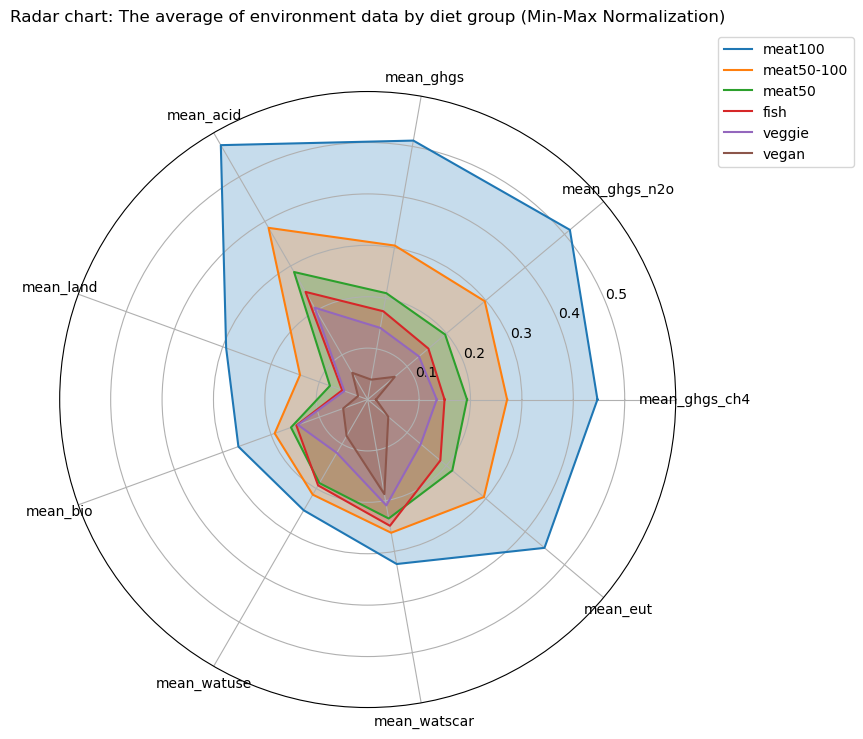

In [6]:
# radar chart
angles = np.linspace(0, 2 * np.pi, len(mean_cols), endpoint=False).tolist()
angles += angles[:1]  

fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={'polar': True})
for group, values in diet_means_sorted_rename.iterrows():
# for group, values in age_means.iterrows():
# for group, values in sex_means.iterrows():
    print("group:",group)
    print("values:",values)
    val_data = values.tolist()
    val_data += val_data[:1]  
    ax.plot(angles, val_data, label=group)
    ax.fill(angles, val_data, alpha=0.25)

ax.set_title("Radar chart: The average of environment data by diet group (Min-Max Normalization)", y=1.1)
ax.set_xticks(angles[:-1])
ax.set_xticklabels(mean_cols)
ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.show()

In [7]:
# from category to number mapping
category_map = {key: idx for idx, key in enumerate(list(reversed(custom_diet_order)))}
df_normalized_copy = df_normalized.copy()
df_normalized_copy['diet_group_numeric'] = df_normalized_copy['diet_group'].map(category_map)
rename_list = list(category_map.keys())
rename_list[rename_list.index('meat')] = 'meat50-100'

fig = px.parallel_coordinates(
    df_normalized_copy,
    dimensions=mean_cols,  
    color='diet_group_numeric',  
    color_continuous_scale='YlOrBr',
    title="Parallel Coordinates Plot: The average of environment data by diet group (Min-Max Normalization)",
)

# add mappting for color bar
fig.update_coloraxes(
    colorbar_tickvals=list(category_map.values()),
    colorbar_ticktext=rename_list
)
fig.show()